The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


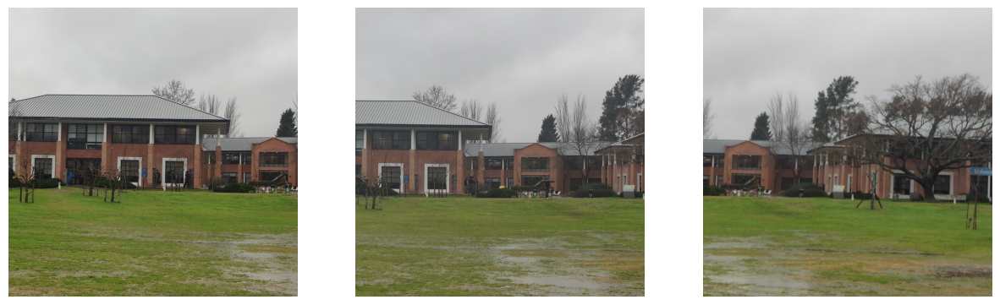

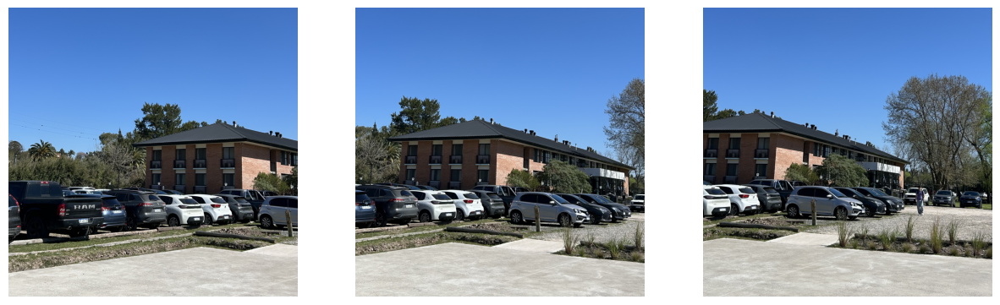

In [43]:
%load_ext autoreload
%autoreload 2

import cv2
import os
import matplotlib.pyplot as plt
import numpy as np

# Ruta de la carpeta que contiene las imágenes
carpeta_imagenes = 'img'

udesa_0 = cv2.imread(os.path.join(carpeta_imagenes, 'udesa_0.jpg'))
udesa_1 = cv2.imread(os.path.join(carpeta_imagenes, 'udesa_1.jpg'))
udesa_2 = cv2.imread(os.path.join(carpeta_imagenes, 'udesa_2.jpg'))

edi_0 = cv2.imread(os.path.join(carpeta_imagenes, 'edi_0.jpg'))
edi_1 = cv2.imread(os.path.join(carpeta_imagenes, 'edi_1.jpg'))
edi_2 = cv2.imread(os.path.join(carpeta_imagenes, 'edi_2.jpg'))

#graficar las imagenes una al lado de la otra
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(udesa_0, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(udesa_1, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(udesa_2, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(edi_0, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 2) 
plt.imshow(cv2.cvtColor(edi_1, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(edi_2, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()


# Detección y descripición de características visuales


[INFO] Detector: SIFT | nfeatures=50000 (UDESA)
· Imagen 0: 22105 keypoints


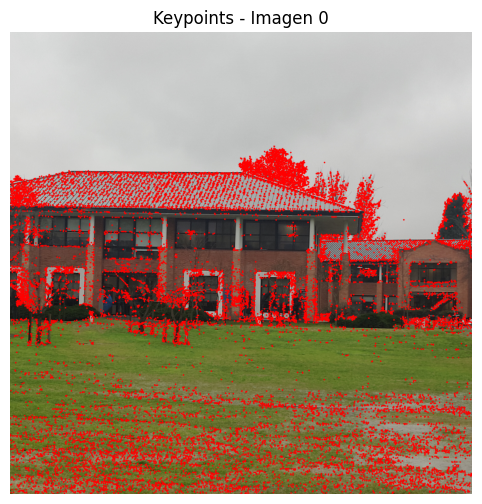

· Imagen 1 (ancla): 14851 keypoints


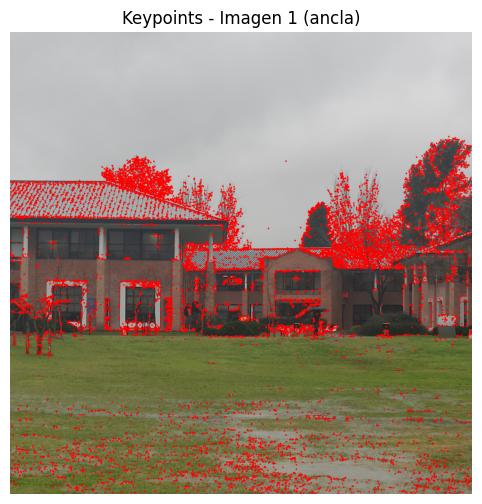

· Imagen 2: 5364 keypoints


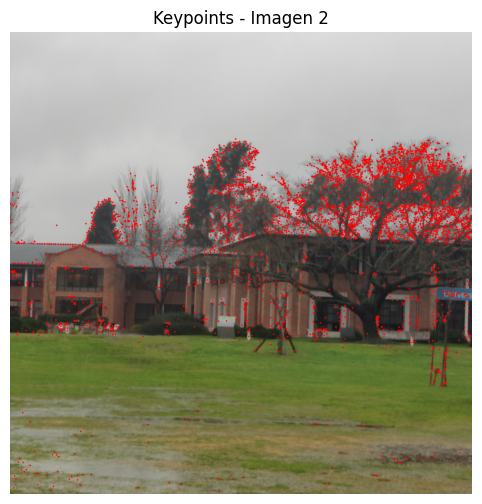


[INFO] Detector: SIFT | nfeatures=22000 (EDI)
· Cuadro 0: 22001 keypoints


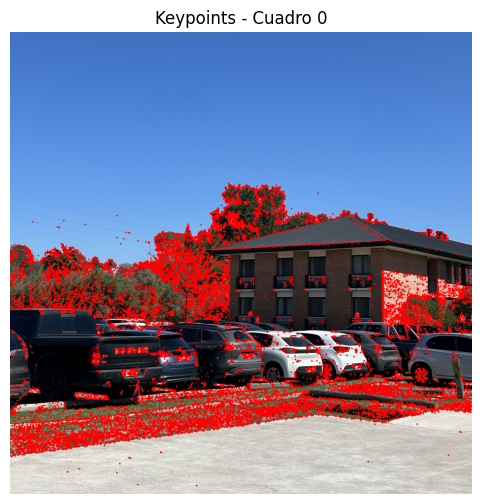

· Cuadro 1: 22000 keypoints


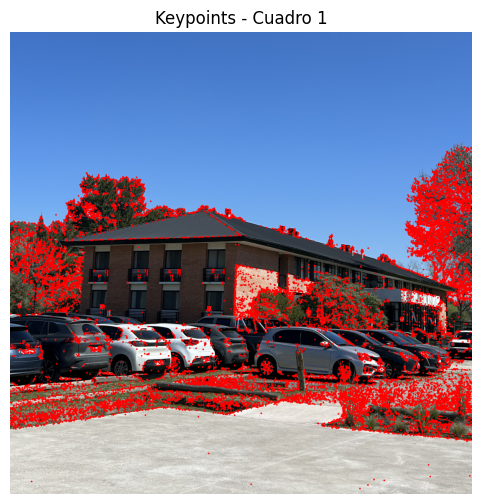

· Cuadro 2: 22000 keypoints


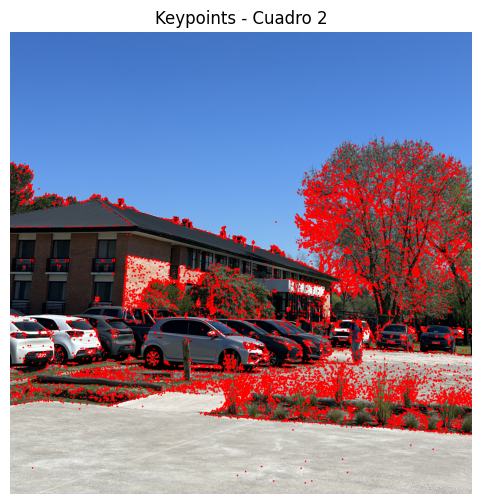

In [44]:
from Utils import detectar_descriptores, mostrar_keypoints

metodo = "SIFT"
nfeatures_udesa = 50_000
nfeatures_edi   = 22_000
mostrar = True  

# UDESA (udesa_0,1,2)
udesa_imgs   = [udesa_0, udesa_1, udesa_2]
udesa_labels = ["Imagen 0", "Imagen 1 (ancla)", "Imagen 2"]

udesa_kp, udesa_des = [], []
print(f"[INFO] Detector: {metodo} | nfeatures={nfeatures_udesa} (UDESA)")
for img, lbl in zip(udesa_imgs, udesa_labels):
    kp, des = detectar_descriptores(img, metodo=metodo, nfeatures=nfeatures_udesa)
    udesa_kp.append(kp); udesa_des.append(des)
    print(f"· {lbl}: {len(kp)} keypoints")
    if mostrar:
        mostrar_keypoints(img, kp, f"Keypoints - {lbl}")

kp0, des0 = udesa_kp[0], udesa_des[0]
kp1, des1 = udesa_kp[1], udesa_des[1]
kp2, des2 = udesa_kp[2], udesa_des[2]

# EDI (fotos propias: edi_0,1,2) 
edi_imgs   = [edi_0, edi_1, edi_2]
edi_labels = ["Cuadro 0", "Cuadro 1", "Cuadro 2"]

edi_kp, edi_des = [], []
print(f"\n[INFO] Detector: {metodo} | nfeatures={nfeatures_edi} (EDI)")
for img, lbl in zip(edi_imgs, edi_labels):
    kp, des = detectar_descriptores(img, metodo=metodo, nfeatures=nfeatures_edi)
    edi_kp.append(kp); edi_des.append(des)
    print(f"· {lbl}: {len(kp)} keypoints")
    if mostrar:
        mostrar_keypoints(img, kp, f"Keypoints - {lbl}")

kp0_edi, des0_edi = edi_kp[0], edi_des[0]
kp1_edi, des1_edi = edi_kp[1], edi_des[1]
kp2_edi, des2_edi = edi_kp[2], edi_des[2]



# 3.2.  Supresión de No Máxima Adaptativa

[INFO] ANMS: N=800 (UDESA)
· Imagen 0: 800 keypoints tras ANMS


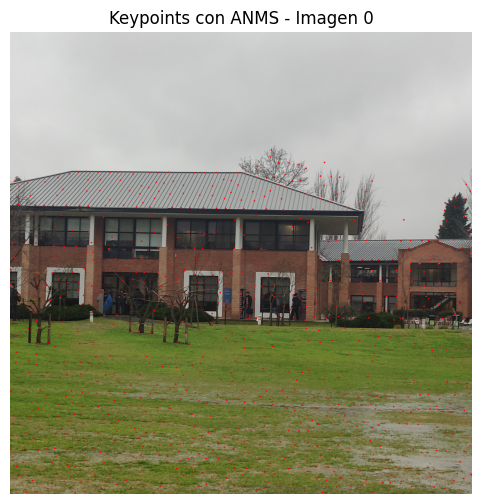

· Imagen 1 (ancla): 800 keypoints tras ANMS


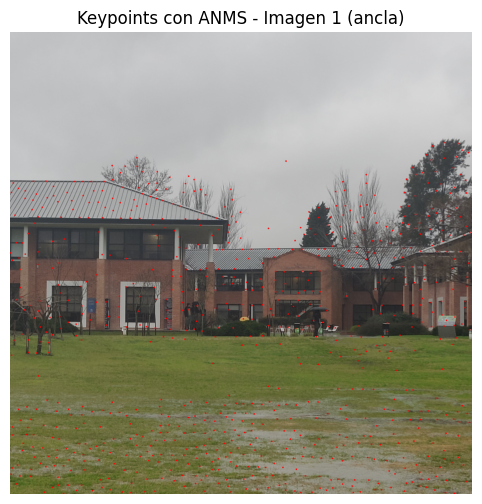

· Imagen 2: 800 keypoints tras ANMS


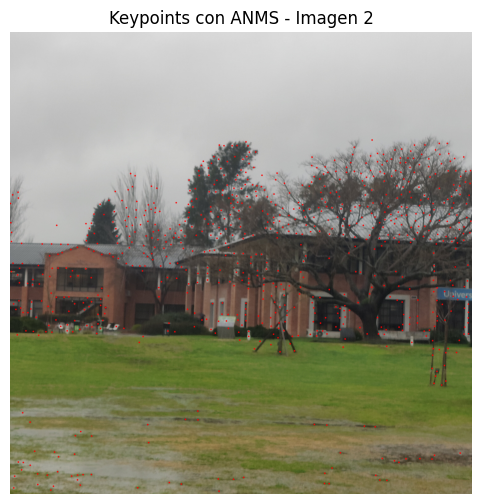


[INFO] ANMS: N=800 (EDI)
· Cuadro 0: 800 keypoints tras ANMS


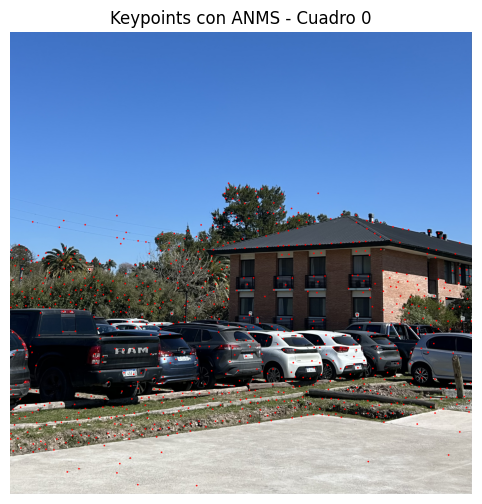

· Cuadro 1: 800 keypoints tras ANMS


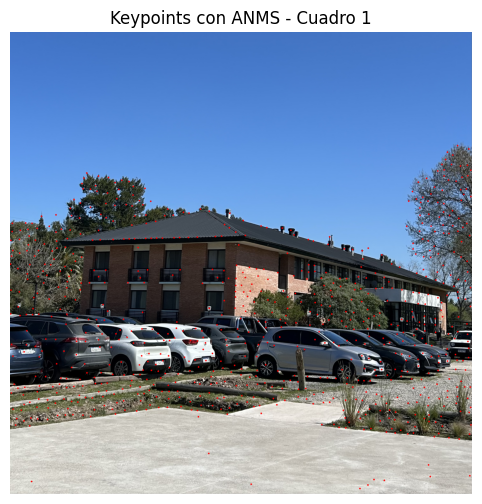

· Cuadro 2: 800 keypoints tras ANMS


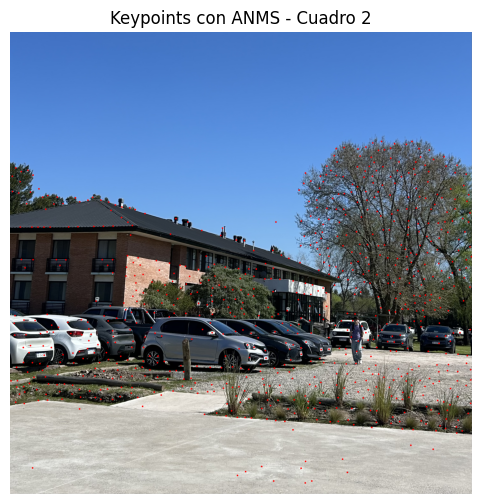

In [45]:
from Utils import aplicar_anms

N_anms  = 800
mostrar = True

# UDESA
udesa_imgs   = [udesa_0, udesa_1, udesa_2]
udesa_labels = ["Imagen 0", "Imagen 1 (ancla)", "Imagen 2"]
udesa_kp     = [kp0, kp1, kp2]

udesa_kp_anms = []
print(f"[INFO] ANMS: N={N_anms} (UDESA)")
for img, lbl, kps in zip(udesa_imgs, udesa_labels, udesa_kp):
    kps_anms = aplicar_anms(kps, N=N_anms)
    udesa_kp_anms.append(kps_anms)
    print(f"· {lbl}: {len(kps_anms)} keypoints tras ANMS")
    if mostrar:
        mostrar_keypoints(img, kps_anms, f"Keypoints con ANMS - {lbl}")

kp0_anms, kp1_anms, kp2_anms = udesa_kp_anms

# EDI (fotos propias)
edi_imgs   = [edi_0, edi_1, edi_2]
edi_labels = ["Cuadro 0", "Cuadro 1", "Cuadro 2"]
edi_kp     = [kp0_edi, kp1_edi, kp2_edi]

edi_kp_anms = []
print(f"\n[INFO] ANMS: N={N_anms} (EDI)")
for img, lbl, kps in zip(edi_imgs, edi_labels, edi_kp):
    kps_anms = aplicar_anms(kps, N=N_anms)
    edi_kp_anms.append(kps_anms)
    print(f"· {lbl}: {len(kps_anms)} keypoints tras ANMS")
    if mostrar:
        mostrar_keypoints(img, kps_anms, f"Keypoints con ANMS - {lbl}")

# Nombres usados en el pipeline
kp0_edi_anms, kp1_edi_anms, kp2_edi_anms = edi_kp_anms



# ASOCIACIÓN DE CARACTERÍSTICAS

Imagen 0: 1013 puntos tras ANMS
Imagen 1: 1012 puntos tras ANMS
Imagen 2: 1010 puntos tras ANMS
Matches 0↔1: 93
Matches 2↔1: 25


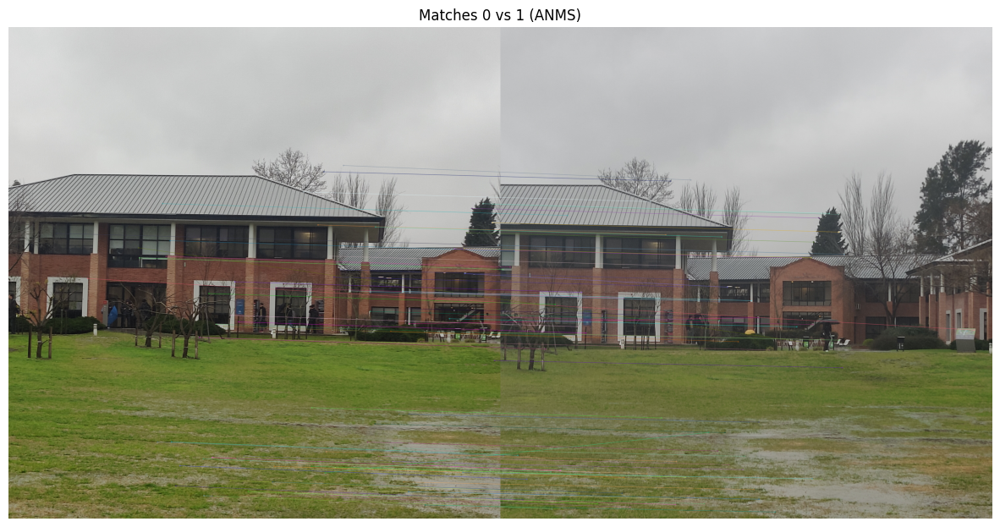

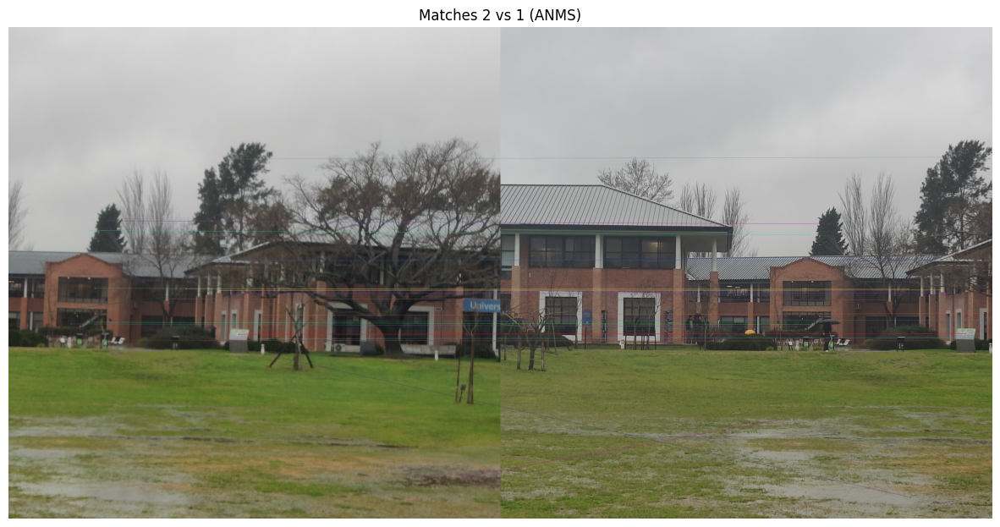

Cuadro 0: 1110 puntos tras ANMS
Cuadro 1: 1104 puntos tras ANMS
Cuadro 2: 1091 puntos tras ANMS
Matches Cuadro 0↔1: 250
Matches Cuadro 2↔1: 215


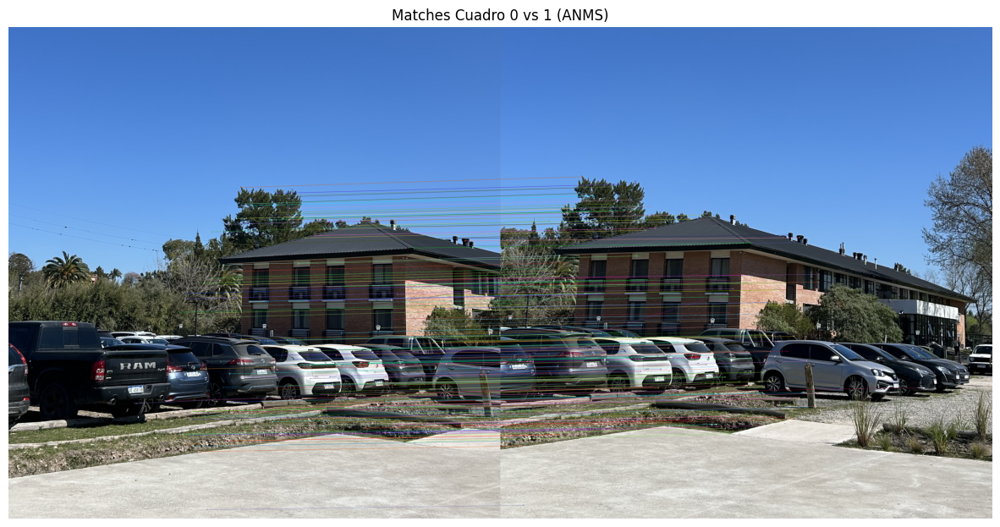

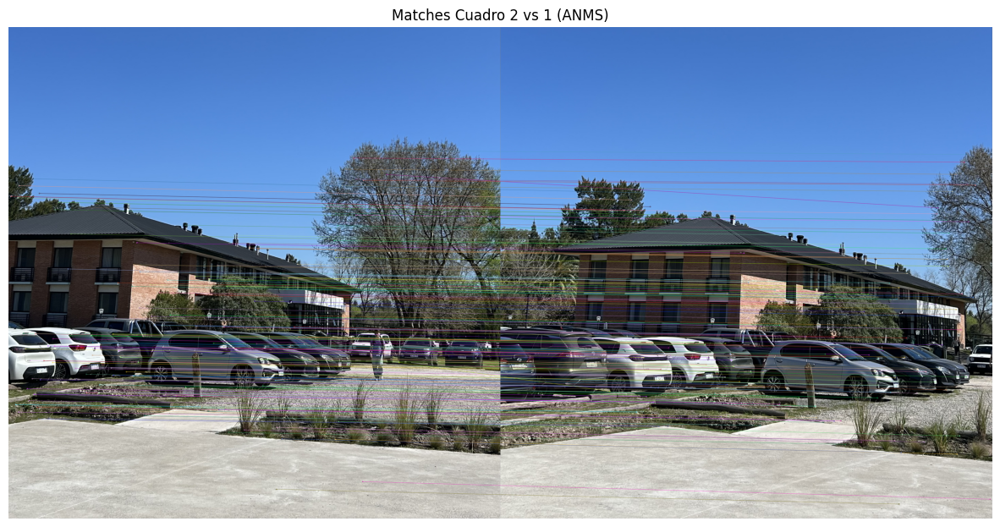

In [46]:
from Utils import filtrar_descriptores, match_features, dibujar_matches

metodo  = "SIFT"
ratio   = 0.75
draw_n  = 800

#  UDESA 
udesa_kp   = [kp0, kp1, kp2]
udesa_des  = [des0, des1, des2]
udesa_anms = [kp0_anms, kp1_anms, kp2_anms]

udesa_kp_final, udesa_des_final = [], []
for i in range(3):
    kpf, desf = filtrar_descriptores(udesa_kp[i], udesa_des[i], udesa_anms[i])
    udesa_kp_final.append(kpf); udesa_des_final.append(desf)
    print(f"Imagen {i}: {len(kpf)} puntos tras ANMS")

# Mantener nombres del pipeline
kp0_final, des0_final = udesa_kp_final[0], udesa_des_final[0]
kp1_final, des1_final = udesa_kp_final[1], udesa_des_final[1]
kp2_final, des2_final = udesa_kp_final[2], udesa_des_final[2]

# Matching respecto a la ancla (1)
matches01 = match_features(des0_final, des1_final, metodo=metodo, ratio=ratio)
matches21 = match_features(des2_final, des1_final, metodo=metodo, ratio=ratio)
print(f"Matches 0↔1: {len(matches01)}")
print(f"Matches 2↔1: {len(matches21)}")

# Visualización
dibujar_matches(udesa_0, kp0_final, udesa_1, kp1_final, matches01, draw_n, titulo="Matches 0 vs 1 (ANMS)")
dibujar_matches(udesa_2, kp2_final, udesa_1, kp1_final, matches21, draw_n, titulo="Matches 2 vs 1 (ANMS)")

#  EDI (fotos propias) 
edi_kp   = [kp0_edi, kp1_edi, kp2_edi]
edi_des  = [des0_edi, des1_edi, des2_edi]
edi_anms = [kp0_edi_anms, kp1_edi_anms, kp2_edi_anms]

edi_kp_final, edi_des_final = [], []
for i in range(3):
    kpf, desf = filtrar_descriptores(edi_kp[i], edi_des[i], edi_anms[i])
    edi_kp_final.append(kpf); edi_des_final.append(desf)
    print(f"Cuadro {i}: {len(kpf)} puntos tras ANMS")

kp0_edi_final, des0_edi_final = edi_kp_final[0], edi_des_final[0]
kp1_edi_final, des1_edi_final = edi_kp_final[1], edi_des_final[1]
kp2_edi_final, des2_edi_final = edi_kp_final[2], edi_des_final[2]

# Matching respecto a la ancla (1)
matches01_edi = match_features(des0_edi_final, des1_edi_final, metodo=metodo, ratio=ratio)
matches21_edi = match_features(des2_edi_final, des1_edi_final, metodo=metodo, ratio=ratio)
print(f"Matches Cuadro 0↔1: {len(matches01_edi)}")
print(f"Matches Cuadro 2↔1: {len(matches21_edi)}")

# Visualización
dibujar_matches(edi_0, kp0_edi_final, edi_1, kp1_edi_final, matches01_edi, draw_n, titulo="Matches Cuadro 0 vs 1 (ANMS)")
dibujar_matches(edi_2, kp2_edi_final, edi_1, kp1_edi_final, matches21_edi, draw_n, titulo="Matches Cuadro 2 vs 1 (ANMS)")


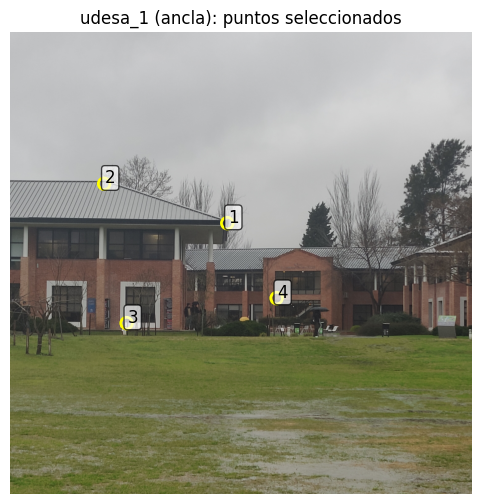

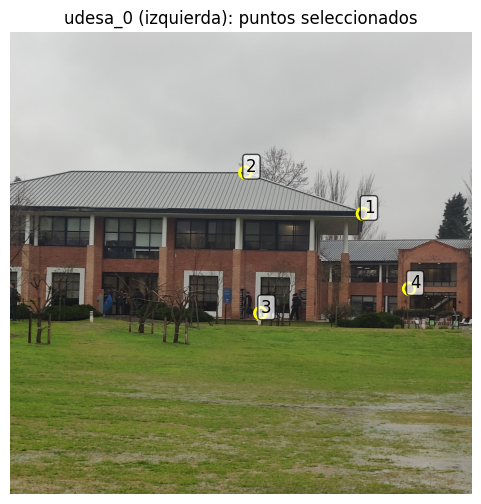

In [47]:
from Utils import show_points

ancla = np.array([
    (1410.21, 1240.57),
    (610.70, 984.89),
    (756.81, 1889.92),
    (1730.83, 1727.58)
])

izq = np.array([
    (2290.90, 1179.69),
    (1527.91, 911.84),
    (1625.31, 1824.99),
    (2591.22, 1666.71)
])

show_points(udesa_1, ancla, title="udesa_1 (ancla): puntos seleccionados")
show_points(udesa_0, izq, title="udesa_0 (izquierda): puntos seleccionados")

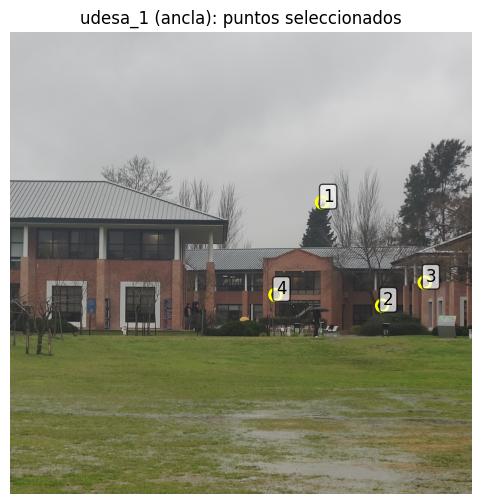

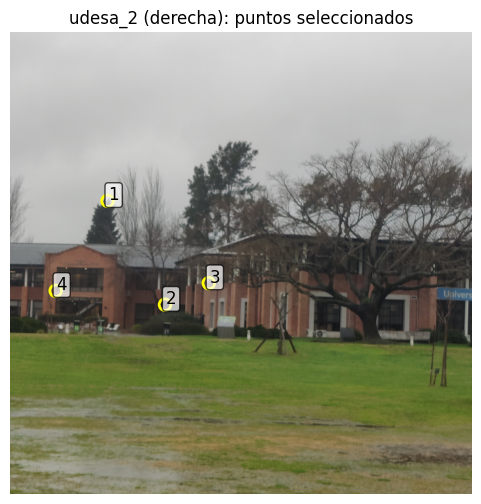

In [48]:
ancla2 = np.array([
    (2026, 1106),
    (2416, 1776),
    (2693, 1626),
    (1723, 1706)
])

der = np.array([
    (633, 1096),
    (1006, 1770),
    (1290, 1630),
    (296, 1680)
])

show_points(udesa_1, ancla2, title="udesa_1 (ancla): puntos seleccionados")
show_points(udesa_2, der, title="udesa_2 (derecha): puntos seleccionados")

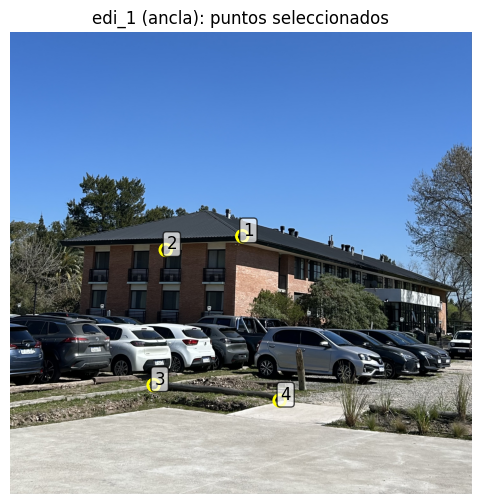

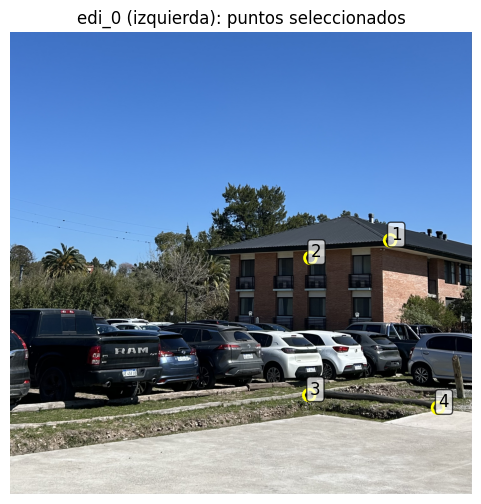

In [49]:
ancla_cuadro = np.array([
    (1456, 1280),
    (976, 1366),
    (900, 2213),
    (1690, 2310)
])

izq_cuadro = np.array([
    (2383, 1306),
    (1883, 1416),
    (1876, 2276),
    (2683, 2356)
])

show_points(edi_1, ancla_cuadro, title="edi_1 (ancla): puntos seleccionados")
show_points(edi_0, izq_cuadro, title="edi_0 (izquierda): puntos seleccionados")

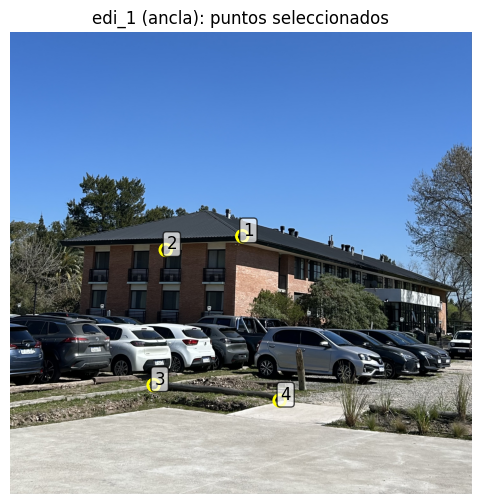

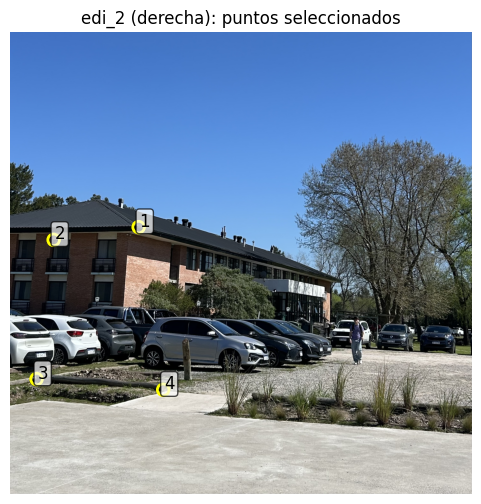

In [50]:
ancla_cuadro2 = np.array([
    (1456, 1280),
    (976, 1366),
    (900, 2213),
    (1690, 2310)
])

der_cuadro = np.array([
    (806, 1223),
    (273, 1303),
    (166, 2176),
    (960, 2243)
])

show_points(edi_1, ancla_cuadro2, title="edi_1 (ancla): puntos seleccionados")
show_points(edi_2, der_cuadro, title="edi_2 (derecha): puntos seleccionados")

In [51]:
from Utils import dlt

H01_manual = dlt(izq, ancla)
H02_manual = dlt(der, ancla2)

H01_manual = H01_manual / H01_manual[2, 2]
H02_manual = H02_manual / H02_manual[2, 2]

E01_manual = dlt(izq_cuadro, ancla_cuadro)
E02_manual = dlt(der_cuadro, ancla_cuadro2)

E01_manual = E01_manual / E01_manual[2, 2]
E02_manual = E02_manual / E02_manual[2, 2]

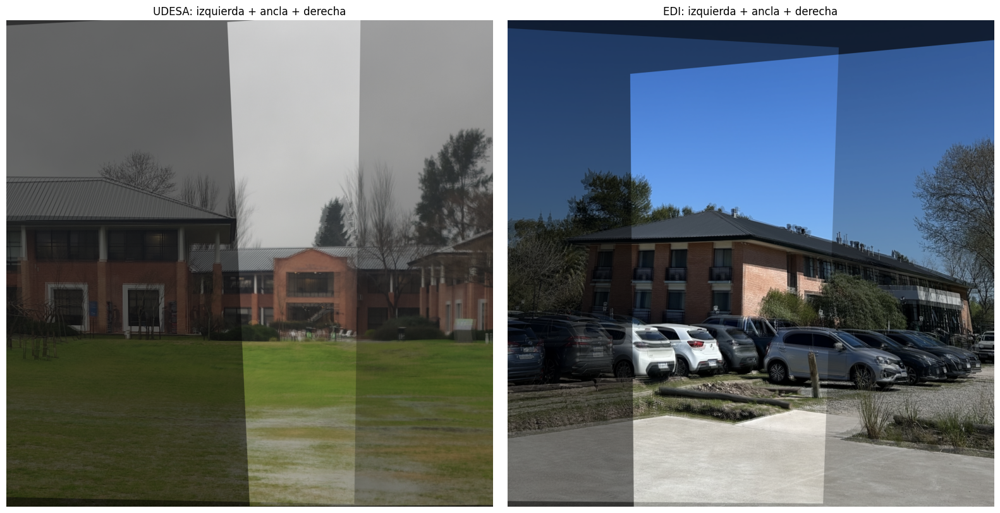

In [52]:
# Parámetros de mezcla 
alpha = 0.5  # peso para izquierda
beta  = 0.5  # peso para derecha

# UDESA 
h1, w1 = udesa_1.shape[:2]
img_left_warped_udesA  = cv2.warpPerspective(udesa_0, H01_manual, (w1, h1))
img_right_warped_udesA = cv2.warpPerspective(udesa_2, H02_manual, (w1, h1))

base_u  = cv2.cvtColor(udesa_1,               cv2.COLOR_BGR2RGB)
left_u  = cv2.cvtColor(img_left_warped_udesA, cv2.COLOR_BGR2RGB)
right_u = cv2.cvtColor(img_right_warped_udesA,cv2.COLOR_BGR2RGB)

overlay_udesa = cv2.addWeighted(base_u, 1 - alpha, left_u, alpha, 0)
overlay_udesa = cv2.addWeighted(overlay_udesa, 1 - beta, right_u, beta, 0)

# EDI 
h2, w2 = edi_1.shape[:2]
img_left_warped_edi  = cv2.warpPerspective(edi_0, E01_manual, (w2, h2))
img_right_warped_edi = cv2.warpPerspective(edi_2, E02_manual, (w2, h2))

base_e  = cv2.cvtColor(edi_1,              cv2.COLOR_BGR2RGB)
left_e  = cv2.cvtColor(img_left_warped_edi,cv2.COLOR_BGR2RGB)
right_e = cv2.cvtColor(img_right_warped_edi,cv2.COLOR_BGR2RGB)

overlay_edi = cv2.addWeighted(base_e, 1 - alpha, left_e, alpha, 0)
overlay_edi = cv2.addWeighted(overlay_edi, 1 - beta, right_e, beta, 0)

# Visualización lado a lado
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
axes[0].imshow(overlay_udesa)
axes[0].set_title("UDESA: izquierda + ancla + derecha")
axes[0].axis("off")

axes[1].imshow(overlay_edi)
axes[1].set_title("EDI: izquierda + ancla + derecha")
axes[1].axis("off")

plt.tight_layout()
plt.show()


# 3.5 RANSAC para eliminacion de otuliers y estimación de homografías


[UDESA 0→1] matches=93 | inliers=57 (61.3%) | τ=3.0
H_0→1 (final):
 [[   1.059    0.01  -970.815]
 [   0.018    1.034   24.556]
 [   0.       0.       1.   ]]
UDESA: Inliers 0 ↔ 1: 57 inliers, 36 outliers (total 93)


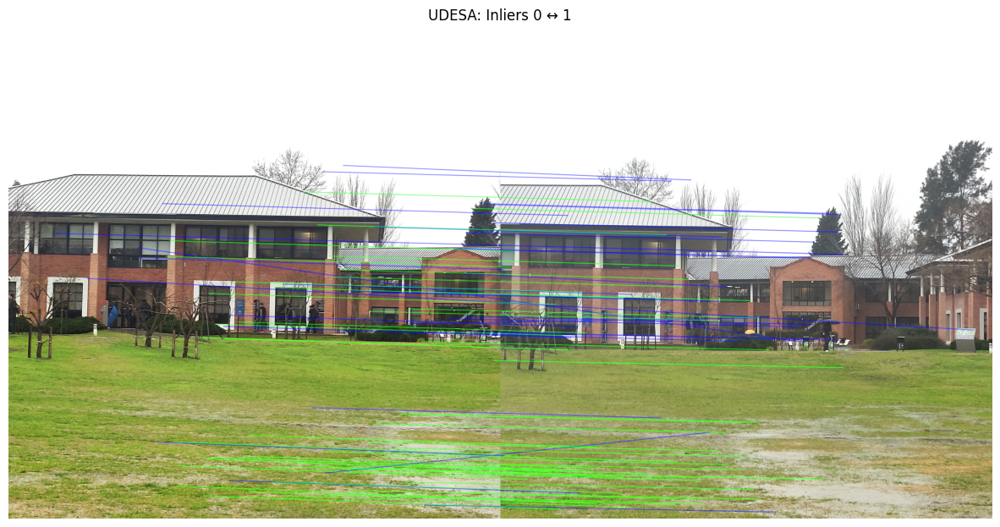

[UDESA 2→1] matches=25 | inliers=11 (44.0%) | τ=4.5
H_2→1 (final):
 [[   0.926    0.048 1361.353]
 [  -0.067    0.985   64.768]
 [  -0.       0.       1.   ]]
UDESA: Inliers 2 ↔ 1: 11 inliers, 14 outliers (total 25)


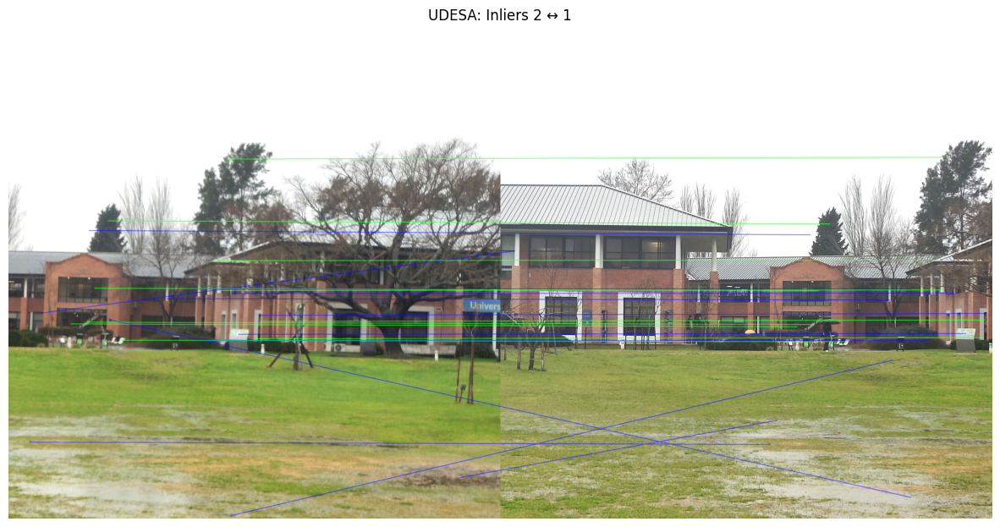

[EDI 0→1] matches=250 | inliers=103 (41.2%) | τ=3.5
H_0→1 (final) [EDI]:
 [[   1.105   -0.077 -926.381]
 [   0.081    1.056 -179.393]
 [   0.      -0.       1.   ]]
EDI: Inliers 0 ↔ 1: 103 inliers, 147 outliers (total 250)


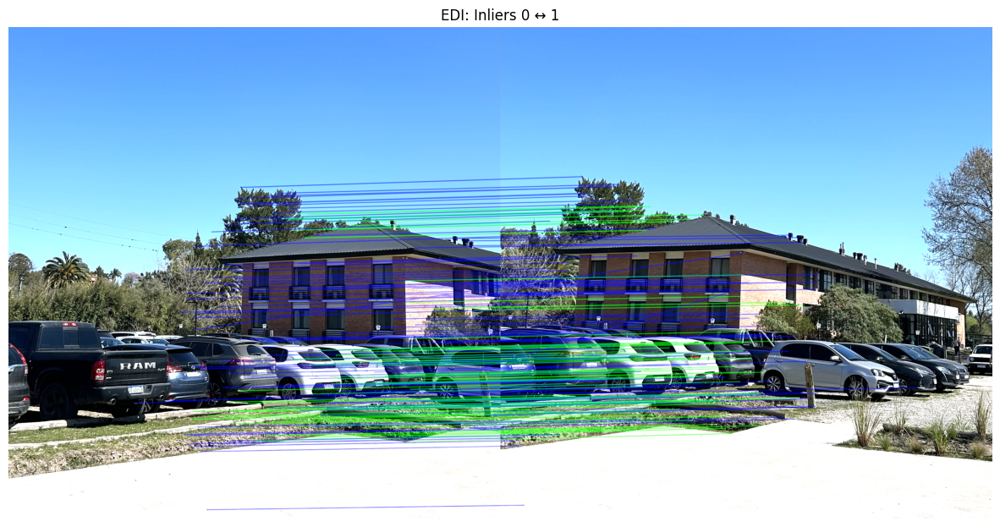

[EDI 2→1] matches=215 | inliers=78 (36.3%) | τ=3.8
H_2→1 (final) [EDI]:
 [[  0.893   0.032 678.002]
 [ -0.055   0.948 128.236]
 [ -0.     -0.      1.   ]]
EDI: Inliers 2 ↔ 1: 78 inliers, 137 outliers (total 215)


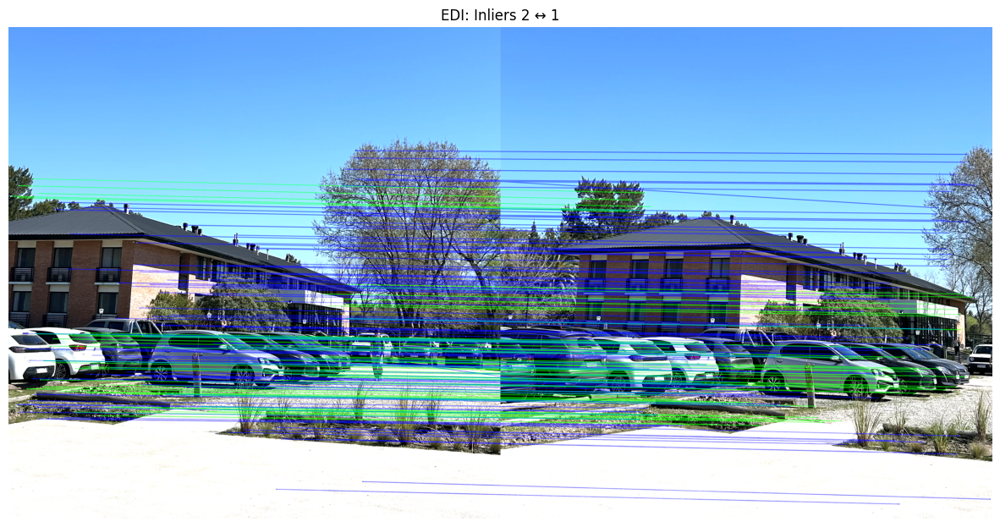

In [53]:
from ransac import ransac_homography, homography_final_opencv
from Utils import extraer_puntos, dibujar_inliers

np.set_printoptions(suppress=True, precision=3) 

# 0 -> 1  (izquierda -> ancla)  [UDESA]

# Extraer pares (x,y) de los matches
pts_src01, pts_dst01 = extraer_puntos(matches01, kp0_final, kp1_final)
assert pts_src01.shape == pts_dst01.shape and pts_src01.shape[0] >= 4, "Se requieren >=4 correspondencias 0->1"

# RANSAC (umbral elegido para este par)
th01 = 3.0
H01_ransac, mask01 = ransac_homography(pts_src01, pts_dst01, thresh=th01, max_trials=5000)

# Asegurar máscara booleana 1D
mask01 = np.asarray(mask01).ravel().astype(bool)

# Refinar con los inliers
H01_final = homography_final_opencv(pts_src01, pts_dst01, mask01)

print(f"[UDESA 0→1] matches={len(matches01)} | inliers={mask01.sum()} ({mask01.sum()/len(matches01):.1%}) | τ={th01}")
print("H_0→1 (final):\n", H01_final)

# Visualización de inliers
dibujar_inliers(
    udesa_0, kp0_final,
    udesa_1, kp1_final,
    matches01, mask01,
    titulo="UDESA: Inliers 0 ↔ 1"
)

# 2 -> 1  (derecha -> ancla)  [UDESA]
pts_src21, pts_dst21 = extraer_puntos(matches21, kp2_final, kp1_final)
assert pts_src21.shape == pts_dst21.shape and pts_src21.shape[0] >= 4, "Se requieren >=4 correspondencias 2->1"

th21 = 4.5
H21_ransac, mask21 = ransac_homography(pts_src21, pts_dst21, thresh=th21, max_trials=5000)
mask21 = np.asarray(mask21).ravel().astype(bool)

H21_final = homography_final_opencv(pts_src21, pts_dst21, mask21)

print(f"[UDESA 2→1] matches={len(matches21)} | inliers={mask21.sum()} ({mask21.sum()/len(matches21):.1%}) | τ={th21}")
print("H_2→1 (final):\n", H21_final)

dibujar_inliers(
    udesa_2, kp2_final,
    udesa_1, kp1_final,
    matches21, mask21,
    titulo="UDESA: Inliers 2 ↔ 1"
)

# 0 -> 1  (izquierda -> ancla)  [EDI / fotos propias]
pts_src01_edi, pts_dst01_edi = extraer_puntos(matches01_edi, kp0_edi_final, kp1_edi_final)
assert pts_src01_edi.shape == pts_dst01_edi.shape and pts_src01_edi.shape[0] >= 4, "Se requieren >=4 correspondencias 0->1 (EDI)"

th01_edi = 3.5
H01_ransac_edi, mask01_edi = ransac_homography(pts_src01_edi, pts_dst01_edi, thresh=th01_edi, max_trials=5000)
mask01_edi = np.asarray(mask01_edi).ravel().astype(bool)

H01_final_edi = homography_final_opencv(pts_src01_edi, pts_dst01_edi, mask01_edi)

print(f"[EDI 0→1] matches={len(matches01_edi)} | inliers={mask01_edi.sum()} ({mask01_edi.sum()/len(matches01_edi):.1%}) | τ={th01_edi}")
print("H_0→1 (final) [EDI]:\n", H01_final_edi)

dibujar_inliers(
    edi_0, kp0_edi_final,
    edi_1, kp1_edi_final,
    matches01_edi, mask01_edi,
    titulo="EDI: Inliers 0 ↔ 1"
)


# 2 -> 1  (derecha -> ancla)  [EDI / fotos propias]
pts_src21_edi, pts_dst21_edi = extraer_puntos(matches21_edi, kp2_edi_final, kp1_edi_final)
assert pts_src21_edi.shape == pts_dst21_edi.shape and pts_src21_edi.shape[0] >= 4, "Se requieren >=4 correspondencias 2->1 (EDI)"

th21_edi = 3.8
H21_ransac_edi, mask21_edi = ransac_homography(pts_src21_edi, pts_dst21_edi, thresh=th21_edi, max_trials=5000)
mask21_edi = np.asarray(mask21_edi).ravel().astype(bool)

H21_final_edi = homography_final_opencv(pts_src21_edi, pts_dst21_edi, mask21_edi)

print(f"[EDI 2→1] matches={len(matches21_edi)} | inliers={mask21_edi.sum()} ({mask21_edi.sum()/len(matches21_edi):.1%}) | τ={th21_edi}")
print("H_2→1 (final) [EDI]:\n", H21_final_edi)

dibujar_inliers(
    edi_2, kp2_edi_final,
    edi_1, kp1_edi_final,
    matches21_edi, mask21_edi,
    titulo="EDI: Inliers 2 ↔ 1"
)



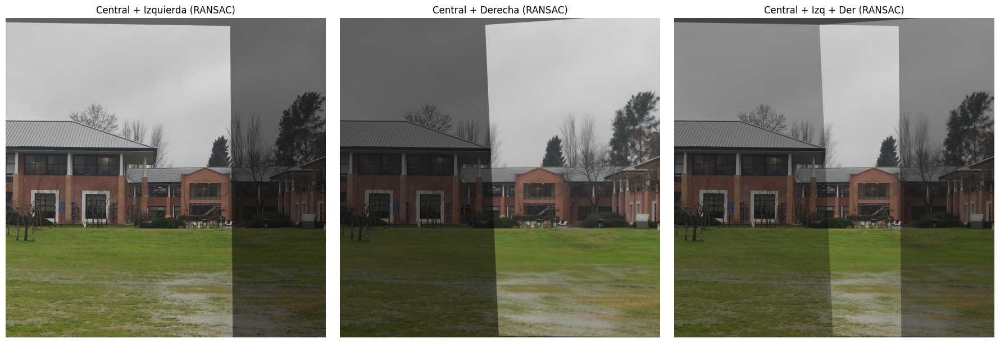

In [54]:
# Warp hacia la imagen ancla (udesa_1)
h, w = udesa_1.shape[:2]
img_left_warped  = cv2.warpPerspective(udesa_0, H01_final, (w, h))
img_right_warped = cv2.warpPerspective(udesa_2, H21_final, (w, h))

# BGR -> RGB para mostrar con matplotlib
img_central = cv2.cvtColor(udesa_1, cv2.COLOR_BGR2RGB)
left_rgb    = cv2.cvtColor(img_left_warped, cv2.COLOR_BGR2RGB)
right_rgb   = cv2.cvtColor(img_right_warped, cv2.COLOR_BGR2RGB)

# Construir overlays
alpha = 0.5  
overlay_left  = cv2.addWeighted(img_central, 1 - alpha, left_rgb,  alpha, 0)
overlay_right = cv2.addWeighted(img_central, 1 - alpha, right_rgb, alpha, 0)

# mezcla de las tres (dos pasos para controlar pesos)
mix_lr = cv2.addWeighted(img_central, 0.5, left_rgb, 0.5, 0)    
overlay_three = cv2.addWeighted(mix_lr, 0.7, right_rgb, 0.3, 0)  

# Plot en una sola fila
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(overlay_left);   axes[0].set_title("Central + Izquierda (RANSAC)"); axes[0].axis("off")
axes[1].imshow(overlay_right);  axes[1].set_title("Central + Derecha (RANSAC)");  axes[1].axis("off")
axes[2].imshow(overlay_three);  axes[2].set_title("Central + Izq + Der (RANSAC)"); axes[2].axis("off")
plt.tight_layout()
plt.show()



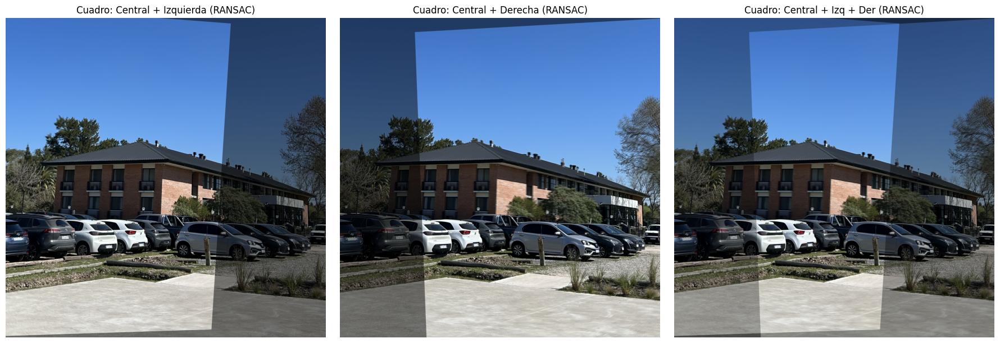

In [55]:
# 1) Warp hacia la imagen ancla (edi_1)
h, w = edi_1.shape[:2]
img_left_warped  = cv2.warpPerspective(edi_0, H01_final_edi, (w, h))
img_right_warped = cv2.warpPerspective(edi_2, H21_final_edi, (w, h))

# 2) BGR -> RGB para mostrar con matplotlib
img_central = cv2.cvtColor(edi_1, cv2.COLOR_BGR2RGB)
left_rgb    = cv2.cvtColor(img_left_warped, cv2.COLOR_BGR2RGB)
right_rgb   = cv2.cvtColor(img_right_warped, cv2.COLOR_BGR2RGB)

# 3) Construir overlays
alpha = 0.5
overlay_left  = cv2.addWeighted(img_central, 1 - alpha, left_rgb,  alpha, 0)
overlay_right = cv2.addWeighted(img_central, 1 - alpha, right_rgb, alpha, 0)

mix_lr = cv2.addWeighted(img_central, 0.5, left_rgb, 0.5, 0)     # central + izquierda
overlay_three = cv2.addWeighted(mix_lr, 0.7, right_rgb, 0.3, 0)  # + derecha

# 4) Visualización: tres paneles en una fila
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(overlay_left);   axes[0].set_title("Cuadro: Central + Izquierda (RANSAC)"); axes[0].axis("off")
axes[1].imshow(overlay_right);  axes[1].set_title("Cuadro: Central + Derecha (RANSAC)");   axes[1].axis("off")
axes[2].imshow(overlay_three);  axes[2].set_title("Cuadro: Central + Izq + Der (RANSAC)"); axes[2].axis("off")
plt.tight_layout()
plt.show()



# 3.6 Cálculo de tamaño óptimo para imágen final

# 3.7 Stiching y Blending

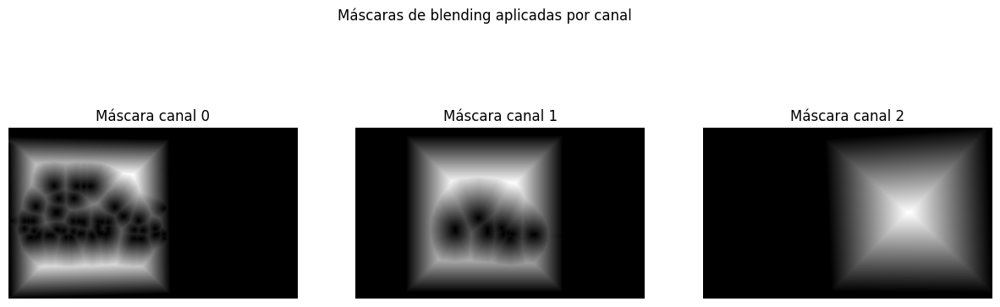

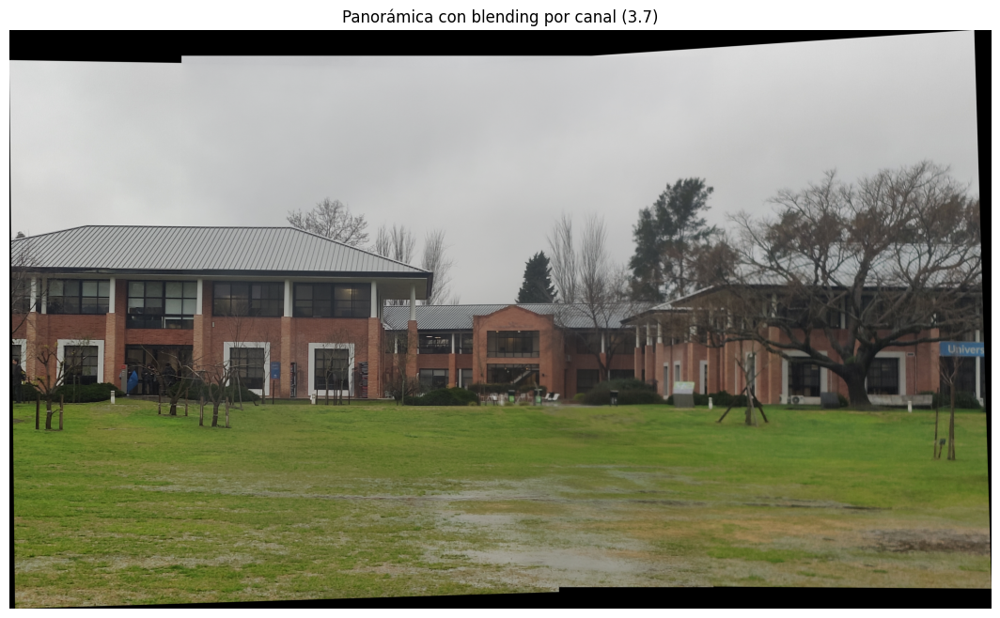

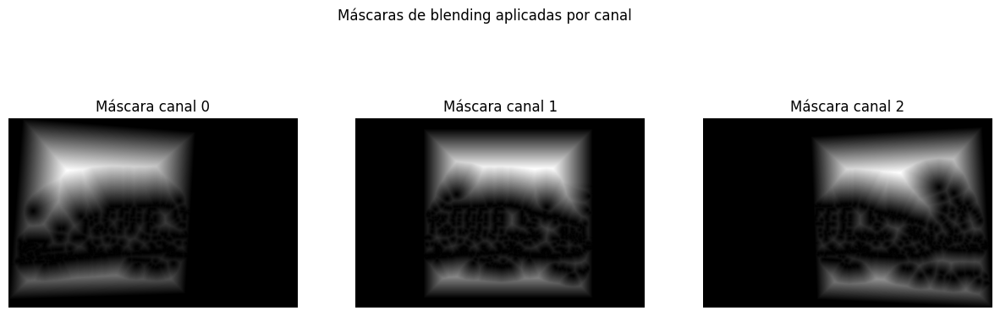

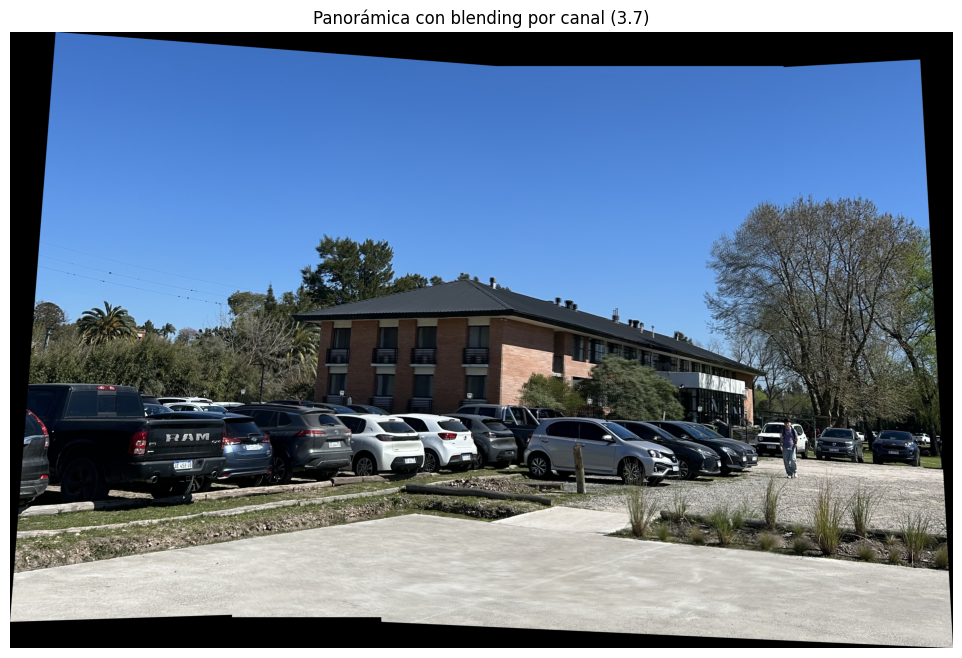

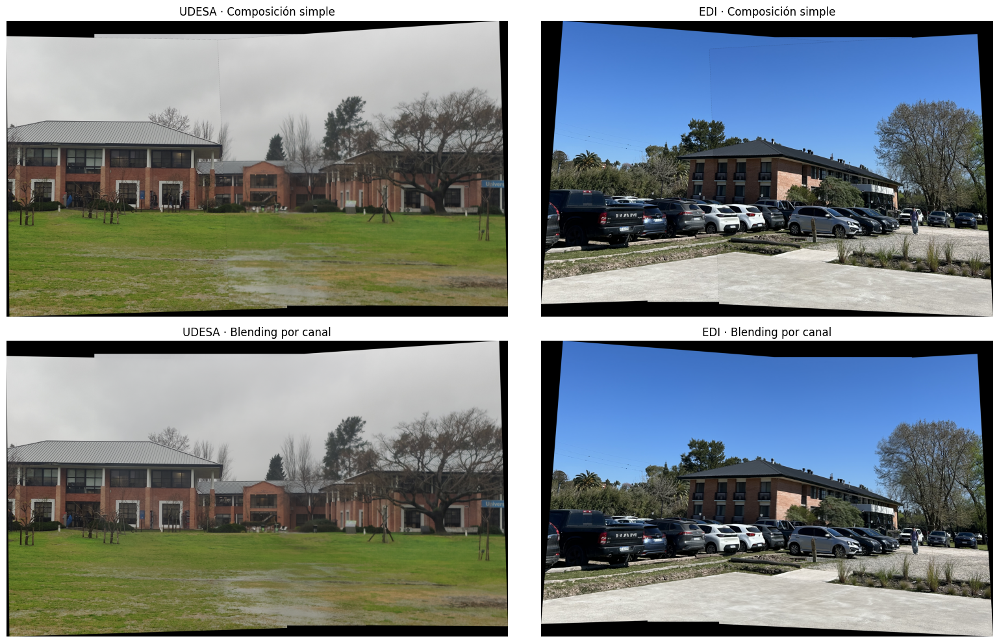

In [ ]:
from Utils import calcular_canvas_optimo, blend_images_por_canal

# (ancla, izquierda, derecha, H_izq→ancla, H_der→ancla, etiqueta)
datasets = [
    (udesa_1, udesa_0, udesa_2, H01_final,     H21_final,     "UDESA"),
    (edi_1,   edi_0,   edi_2,   H01_final_edi, H21_final_edi, "EDI"),
]

no_blend_rgbs = []   # composiciones simples (pegar sin mezclar)
blend_rgbs    = []   # composiciones con blend por canal
titles        = []

for anchor, left, right, H_LA, H_RA, label in datasets:
    # Canvas óptimo y traslación común
    T, size = calcular_canvas_optimo(anchor, left, right, H_LA, H_RA)  # size=(W,H)

    # Warps al canvas
    warp_left   = cv2.warpPerspective(left,   T @ H_LA, size)
    warp_right  = cv2.warpPerspective(right,  T @ H_RA, size)
    warp_anchor = cv2.warpPerspective(anchor, T,        size)

    # Composición simple (no pisa negros)
    canvas = warp_anchor.copy()
    mask_left  = (cv2.cvtColor(warp_left,  cv2.COLOR_BGR2GRAY)  > 0)
    mask_right = (cv2.cvtColor(warp_right, cv2.COLOR_BGR2GRAY) > 0)
    canvas[mask_left]  = warp_left[mask_left]
    canvas[mask_right] = warp_right[mask_right]
    no_blend_rgbs.append(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))

    # BLENDING por canal 
    panorama_final = blend_images_por_canal([warp_left, warp_anchor, warp_right], mostrar=True)

    try:
        pano_blend_rgb = cv2.cvtColor(panorama_final, cv2.COLOR_BGR2RGB)
    except cv2.error:
        pano_blend_rgb = panorama_final  # ya estaba en RGB
    blend_rgbs.append(pano_blend_rgb)

    titles.append(label)

# Mostrar resultados: fila 1 = composición simple, fila 2 = blending por canal
cols = len(titles)
fig, axes = plt.subplots(2, cols, figsize=(8*cols, 10))
if cols == 1:
    axes = np.array([[axes[0]], [axes[1]]])  # normalizar indexado si hay 1 columna

for j in range(cols):
    axes[0, j].imshow(no_blend_rgbs[j])
    axes[0, j].set_title(f"{titles[j]} · Composición simple")
    axes[0, j].axis("off")

    axes[1, j].imshow(blend_rgbs[j])
    axes[1, j].set_title(f"{titles[j]} · Blending por canal")
    axes[1, j].axis("off")

plt.tight_layout()
plt.show()
